# "Training UGATIT in FP16"
> "Hello, this is one of my full-time self learning projects. This was done in fastai2⁹, my GPU setups for this will be two 2070 Supers. The goal of this was to use fp16 training on U-GAT-IT. I did not do any of this in a controlled and meticulous experiment fashion. While I do agree that this is very important, I found that I had to forgo this in order to get something working. For the first two months of this I did not even have a working model for example. The target audience for this post is someone with either a single MOOC or introductory deep learning class, if you are in this category and do not understand something, feel free to leave a comment and I will try to answer your question, and update the article to be clearer. If you do not have any knowledge on deep learning this article might be a bit difficult, feel free to ask questions and I will do the best to answer them, and I really recommend learning fastai at https://course.fast.ai/"

- toc:true
- branch: master
- badges: true
- comments: true
- author: Molly Beavers
- categories: [UGATIT,FP16,GAN,Image Generation,Image to Image]

In [58]:
from nbdev import export2html
from pathlib import Path
from PIL import Image

## Training U-GAT-IT with fp16

Hello, this is one of my full-time self learning projects. This was done in fastai2⁹, my GPU setups for this will be two 2070 Supers. The goal of this was to use fp16 training on U-GAT-IT. I did not do any of this in a controlled and meticulous experiment fashion. While I do agree that this is very important, I found that I had to forgo this in order to get something working. For the first two months of this I did not even have a working model for example. The target audience for this post is someone with either a single MOOC or introductory deep learning class, if you are in this category and do not understand something, feel free to leave a comment and I will try to answer your question, and update the article to be clearer. If you do not have any knowledge on deep learning this article might be a bit difficult, feel free to ask questions and I will do the best to answer them, and I really recommend learning fastai at https://course.fast.ai/

## Results

Outputs

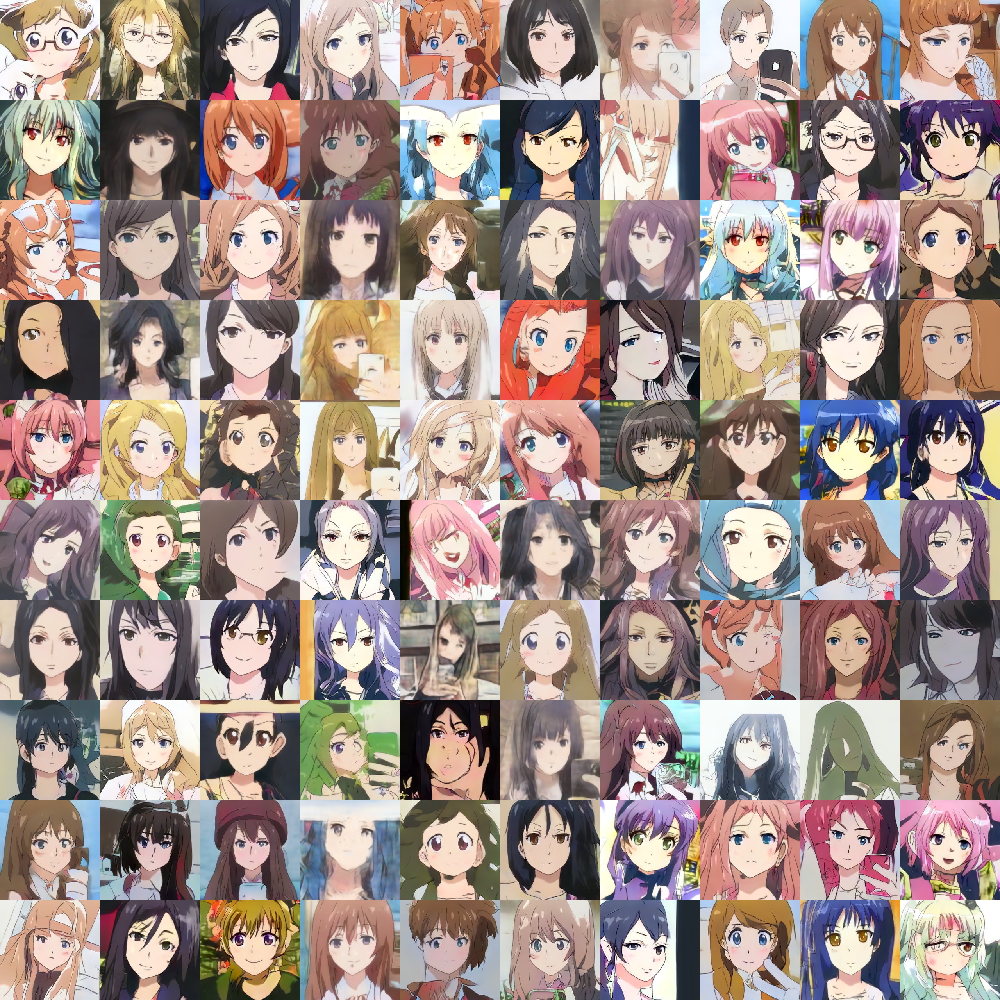

In [59]:
Image.open('imgs/big_img13.png')

Inputs

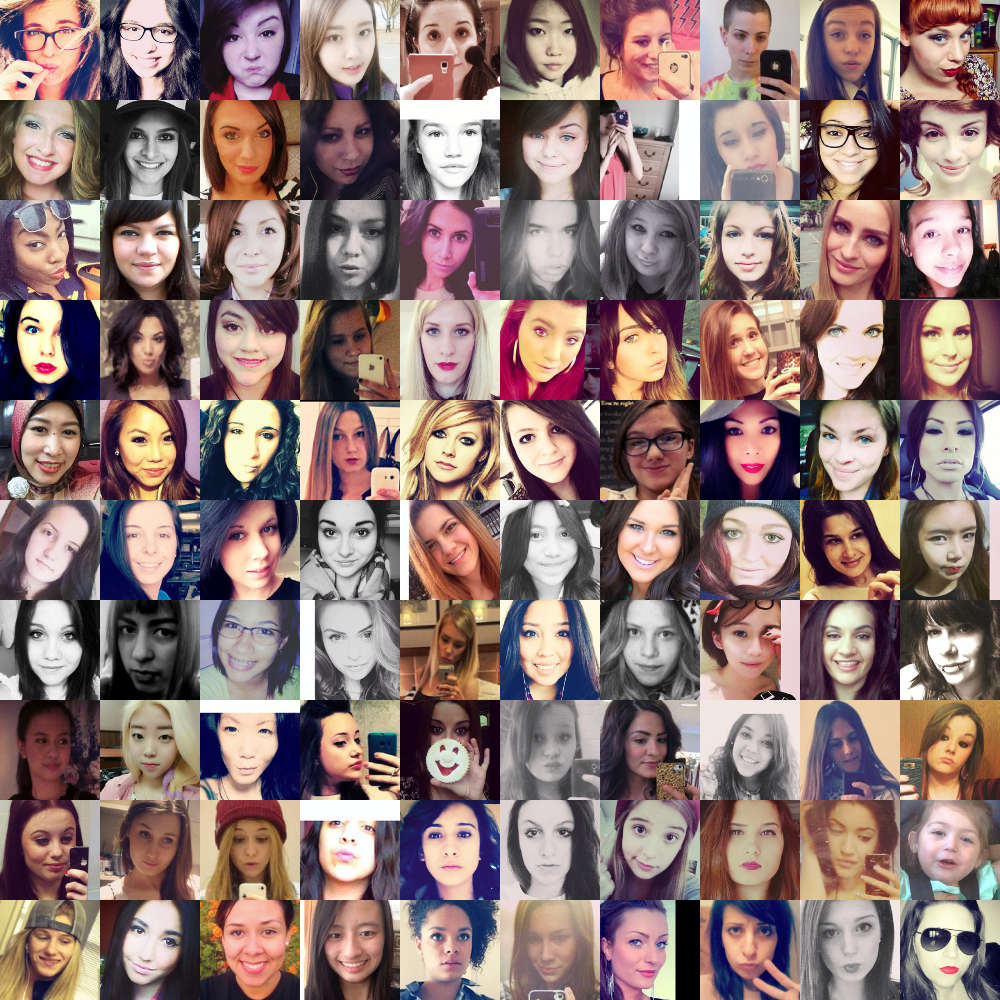

In [60]:
Image.open('imgs/big_img11.png')

## Background

GANs³ are generational adversarial networks, or in this case, a network than generates images, and another network that tells if it is real or fake. The two networks then compete to be better than the other, and that is how we get a network that can generate images. CycleGan² in based off of this idea, but the generators take an image as input, the output of a generator is sent through the second generator, and and the output of the second generator must match the input of the first generator. This way a generator can't learn to simply generate an image regardless of its input, and must encode information from the original image all throughout the whole "Cycle".
Network architecture for The Generator of U-GAT-IT¹Network architecture for The Discriminator of U-GAT-IT¹This post is based on the U-GAT-IT¹ architecture above, and is a project I worked on in order to get U-GAT-IT training on my GPUs in fp16. U-GAT-IT showed good results on anime based images. It introduces a few things, such as the selfie2anime dataset, adaptive layer-instance norm, Class-Activation Map Loss, and more. Those who have seen the 2019 fastai course should know that Class Activation Mapping is how you get a heatmap of your network activating on a particular image. The architecture of the network is based on Cycle GAN, and has a total of two generators and four discriminators. 

## FP16

Getting fp16 training working for U-GAT-IT was definitely what I spent the majority of the past few months doing. To get this to work I needed to use Mixed Precision Training⁴. I tried many things, but eventually found that the "most" code, with the "most" complicated looking training loop was the way to go, definitely something I am not used to saying. This meant that many of my earlier simpler but unsuccessful experiments meant that I was very disheartened by the time I actually got anything working. This "complicated" way was implementing loss scaling separately for both the generators and discriminator of U-GAT-IT. This came with challenges about how to handle overflow and tracking all the variables associated with loss scaling separately.

Reduced range in fp16⁴Now I will start with a few definitions, fp16 overflow is when your gradients are too big too fit within fp16. Underflow is when fp16 gradients are so close to 0 that they are simply rounded to 0. Overflow and underflow can happen in fp32 as well, but isn't nearly as big of a problem because fp32 is simply "bigger." Loss scaling is multiplying our loss by as large a value as possible,which effectively is multiplied by our gradients. This avoids underflow by increasing the gradients, but we need to make sure it is not big enough that it causes an overflow. One technicality to loss scaling is calculating the loss itself in fp32, because calculating a loss includes division and low precision division is very in-precise leading to unstable gradients/training. Another technicality is that the gradients have to be divided by the loss scale, to keep the magnitudes consistent with a fp32-bit model, otherwise this would be very similar to simply increasing the learning rate by the loss scale! But, wait a minute… if we divide by the loss scale won't we just run into the underflow issue from before? Your right, we have to have a fp32 copy of the weights as well, so that we can avoid this problem. We copy the scaled gradients over to an fp32 model and then divide by the loss scale there. We then continue the optimization step in fp32.

So, I haven't talked about how I handled overflow yet, because that actually gets into the GAN specifics of the training loop. I found that the discriminator was unable to converge without a fairly high loss scale, and the generator overflowed at a comparatively low loss scale. This was because the generator has a much higher loss, but I will get into that latter, or you can skip to "Tanh Loss". This differing requirement of loss scale means that we need to track the loss scale separately for the generator and discriminator. We also have two states for overflow failure, overflow in the generator, and overflow in the discriminator. In the case of the discriminator I simply grab another set of samples from the training set, and generate a new fake and compare to real as usual. For a generator overflow, I simply skip to the next batch. Skipping to the next batch is a problem because the total number of successfully run batches is not accounted for currently in my training loop, so there is some variations in the amount of training done, I would like to fix this in the future.

## Batch Size of 3

Batch size of three was the maximum I could reasonably get out of my model, given memory limitations. In a GAN architecture there are trade offs of increasing the batch size. I found that in my case, the very first convolution layer had a tendency to overflow, at fairly irregular intervals. Increasing the batch size to three mostly smoothed this out so that I could have orders of magnitude higher loss scale. 

## 2-category Categorical Cross Entropy VS Binary Cross Entropy with Logits

For people not overly familiar with loss functions, Categorical Cross Entropy is the loss function generally used for selecting a single category, out of many. Examples of tasks that use Categorical Cross Entropy are Imagenet Classification or Dog vs Cat. Dog vs Cat is a special case, because there are only two choices, Dog or Cat, this is what I am referring to when I say 2-category Categorical Cross Entropy. Binary Cross Entropy with Logits is very similar, but uses a Sigmoid into a Binary Cross Entropy Loss, which is calculating loss based on distance from either 0 or 1. This means that Categorical Cross Entropy requires 2 values one for each category, and Binary cross entropy calculates loss based on one value ranging from 0 to 1. In order to avoid overflow, I wanted to be able to raise weight decay to the largest value possible, well Binary Cross Entropy works by sending values through a Sigmoid and then seeing if the value is close to 1, but weight decay pushes these values to 0, which after going through Sigmoid equals 0.5. So, instead I decided to use loss that used Softmax instead. This allows small values to be "highly confident", because if you have two small values (0.0099,0.00001) you can still get large numbers to send into the loss calculation (0.0099/(0.0099+0.00001)).

## Tanh Loss

In [ ]:
loss_A += u.cam_weight * self.tanh(u.cam_loss(fake_B2A_cam_logit,fake_A2A_cam_logit))

Before I talk about why I decided to change up the loss function, I think it is important to understand a bit about CAM loss, which was mentioned previously. CAM loss is based on class activation mapping⁸, and is used in U-GAT-IT as part of a differential loss function. This important thing here is that CAM loss is multiplied by 1000. There are two functions of CAM loss which behave similarly, so for our calculations lets just say that cam loss is 2000*loss. The maximum value for fp16 is 65504 so if we divide this by our multiplier we find that we overflow at a loss of approximately 32. Considering the fact that this loss can easily be over 1, we are calculating gradients for every parameter, and we get less precise the closer we get to this maximal value, hard decisions had to be made to simply get this model training on fp16. I decided to send the CAM loss through a hyperbolic tangent, which effectively limits its maximum value to 1, before adding it to the rest of the loss function. This meant that the formula for cam loss went from loss = 2000*loss to 2000*tanh(loss). Limiting the maximum value of this loss to 1 downshifts the importance of cam loss in the beginning when the model starting training, but allows it to quickly ramp up when the model starts to get it right. This seems to cause a big shift in the loss when the gradient of this loss is quickly increasing.
<insert graph of loss without tanh>,<insert graph of loss with tanh>

## Normalization

It is very important to add that I added extra normalization layers, I have not done proper testing to determine the effect of these layers, but they did decrease the magnitude of the gradients which was the intended effect. All normalization had to of course be done in fp32, whether I added it or it was already part of the network. 

## Tooling

This work used fastai2⁹, which is much more hackable than previous versions of fastai. I started working on this last October, so at the time there was not very much support for GAN training ported into fastai2. Still, the hackable nature of fastai2 let me work my training loop into the one used for regular image classification and similar tasks. Fastai2 really provides you a great way to help organize your code, even when you are not using models or training loops in a purely out-of-the-box sort of way. The dataloading was also improved in this version, and allowed for things like on GPU data augmentations, and easy way to compose this data pipeline. I also was able to edit much of the code there to add in functionality that I was trying to create.
Having the WandbCallback in fastai was instrumental in tracking training and identifying where I should spend time optimizing training. By tracking gradients in weights and biases¹⁰ as well as all of the other hyper parameters, I was able to easily identify what my current goal should be, as well as have some hope that the network would eventually train. Watching for small improvements in logs over the course of training was the only way I could tell the model was working better in fp16, as the output of the model didn't really improve much.

## Contact Me

Linked-In Profile: https://www.linkedin.com/in/molly-beavers-651025118/

Source Code: https://github.com/marii-moe/selfie2anime

## References 

[1] Junho Kim, Minjae Kim, Hyeonwoo Kang and Kwang Hee Lee. U-GAT-IT: Unsupervised Generative Attentional Networks with Adaptive Layer-Instance Normalization for Image-to-Image Translation. International Conference on Learning Representations. 2020 https://openreview.net/forum?id=BJlZ5ySKPH
[2] Jun-Yan Zhu*, Taesung Park*, Phillip Isola, and Alexei A. Efros. "Unpaired Image-to-Image Translation using Cycle-Consistent Adversarial Networks", in IEEE International Conference on Computer Vision (ICCV), 2017. (* indicates equal contributions). https://arxiv.org/pdf/1703.10593.pdf
[3] Ian J. Goodfellow, Jean Pouget-Abadie, Mehdi Mirza, Bing Xu, David Warde-Farley, Sherjil Ozair, Aaron Courville, Yoshua Bengio."Generative Adversarial Networks." ArXiv, 2014. https://arxiv.org/abs/1406.2661
[4] Micikevicius, P., Narang, S., Alben, J., Diamos, G.F., Elsen, E., García, D., Ginsburg, B., Houston, M., Kuchaiev, O., Venkatesh, G., & Wu, H."Mixed Precision Training". ArXiv, 2017. https://arxiv.org/abs/1710.03740
[5] Chen, T., Xu, B., Zhang, C., & Guestrin, C. "Training Deep Nets with Sublinear Memory Cost". ArXiv, 2016. https://arxiv.org/abs/1604.06174
[6] Jason Antic. "DeOldify". https://github.com/jantic/DeOldify
[7] Hicsonmez, Samet & Samet, Nermin & Akbas, Emre & Duygulu, Pinar. "GANILLA: Generative adversarial networks for image to illustration translation". Elsevier Image and Vision Computing 103886, 2020. https://arxiv.org/abs/2002.05638
[8] Zhou, B. & Khosla, A. and Lapedriza. A. and Oliva, A. and Torralba, A. "Learning Deep Features for Discriminative Localization." CVPR, 2016. http://cnnlocalization.csail.mit.edu/
[9] Howard, J., & Gugger, S. fastai: A Layered API for Deep Learning. ArXiv, 2020. https://arxiv.org/abs/2002.04688
[10] Biewald, Lukas. "Experiment Tracking with Weights and Biases". 2020. https://www.wandb.com/

In [61]:
export2html.notebook2html(fname='2020-06-11-UGATIT-a-GAN-in-fp16.ipynb', dest='html/', template_file='fastpages.tpl',n_workers=1)

converting: 2020-06-11-UGATIT-a-GAN-in-fp16.ipynb


In [ ]:
nbde